In [42]:
from donkeycar.gym import remote_controller

import matplotlib.pyplot as plt
import numpy as np
import time

from IPython.display import clear_output

In [38]:
import torch
from torchvision import transforms

In [39]:
controller = remote_controller.DonkeyRemoteContoller(donkey_name="Kari", mqtt_broker="mqtt.eclipse.org")

(clean_session) connecting to broker mqtt.eclipse.org
connected.
connecting to broker mqtt.eclipse.org
connected.


In [40]:
im = controller.observe()

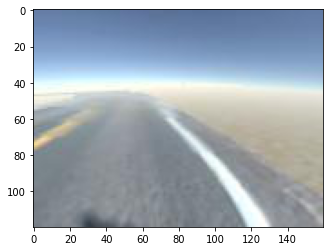

In [41]:
plt.imshow(im)

In [48]:
th = 150
width = 20
height = 20

while True:
    im = controller.observe()
    clear_output(wait=True)
    orig = im
    im = im[-height:,width:-width,:]
    pixels = len(im.flatten())
    r = im[:,:,0] < th
    g = im[:,:,1] < th
    b = im[:,:,2] < th
    
    plt.figure(1, (20, 5))
    plt.subplot(1, 4, 1)
    plt.imshow(orig)
    plt.subplot(1, 4, 2)
    plt.imshow(im.mean(axis=2) < th)
    plt.subplot(1, 4, 3)
    plt.imshow(b)
    plt.subplot(1, 4, 4)
    plt.imshow(r & b & g)
    plt.show()
    print((r & g & b).sum() / (pixels / 3))

KeyboardInterrupt: 

In [100]:
controller.take_action((0, 0))

In [104]:
controller.take_action((0, 0.1))

In [108]:
controller.take_action((-0.0, 0.1))

KeyboardInterrupt: 

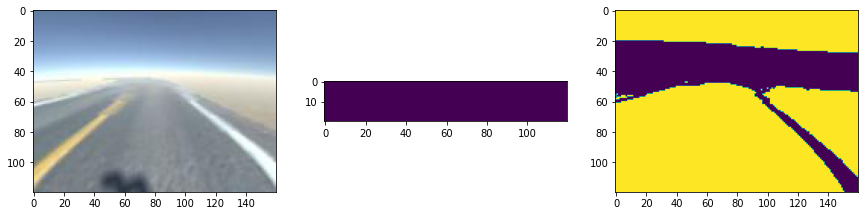

In [109]:
th = 190
width = 20
height = 20

#controller.take_action((0.2, 0.2))

while True:
    im = controller.observe()
    clear_output(wait=True)
    orig = im
    im = im[-height:,width:-width,:]
    pixels = len(im.flatten())
    r = im[:,:,0] > th
    g = im[:,:,1] > th
    
    rgb = orig[:,:,0] > orig[:,:,2]
    
    #if rgb[100:].sum() / (20 * 160) > 0.5:
    #    controller.take_action((0, 0))

    plt.figure(1, (20, 5))
    plt.subplot(1, 4, 1)
    plt.imshow(orig)
    plt.subplot(1, 4, 2)
    plt.imshow(im.mean(axis=2) < th)
    plt.subplot(1, 4, 3)
    plt.imshow(b)
    plt.subplot(1, 4, 4)
    plt.imshow(rgb)
    plt.show()

In [84]:
controller.take_action((0, 0))

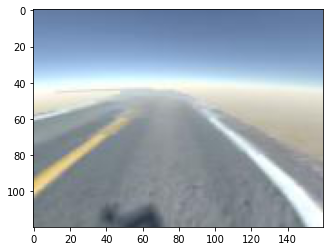

In [50]:
plt.imshow(orig)

(array([ 8., 28., 16., 20., 25., 19., 19., 18., 24., 23.]),
 array([179., 182., 185., 188., 191., 194., 197., 200., 203., 206., 209.]),
 <a list of 10 Patch objects>)

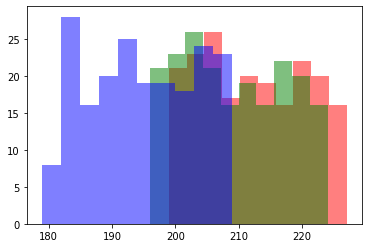

In [56]:
plt.hist(orig[50:60,140:160,0].flatten(), color="r", alpha=0.5)
plt.hist(orig[50:60,140:160,1].flatten(), color="g", alpha=0.5)
plt.hist(orig[50:60,140:160,2].flatten(), color="b", alpha=0.5)

In [62]:
im = orig

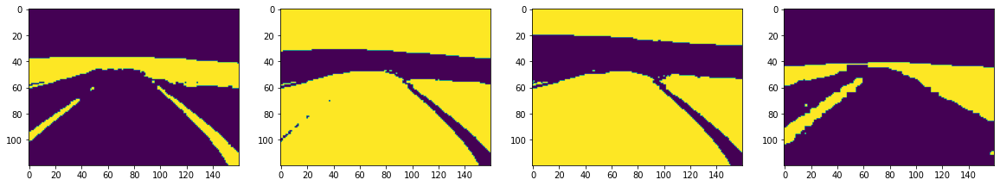

0.021197916666666667


In [71]:
    th = 200
    pixels = len(im.flatten())
    r = im[:,:,0] > th
    g = im[:,:,1] > th
    b = im[:,:,2] < th
    
    rgb = im[:,:,0] > im[:,:,2]
    
    
    plt.figure(1, (20, 5))
    plt.subplot(1, 4, 1)
    plt.imshow(r)
    plt.subplot(1, 4, 2)
    plt.imshow(im.mean(axis=2) < th)
    plt.subplot(1, 4, 3)
    plt.imshow(b)
    plt.subplot(1, 4, 4)
    plt.imshow(rgb)
    plt.show()
    print((r & g & b).sum() / (pixels / 3))


In [25]:
ims = []

In [26]:
for i in range(1000):
    im = controller.observe()
    ims.append(im)
    time.sleep(0.1)

KeyboardInterrupt: 

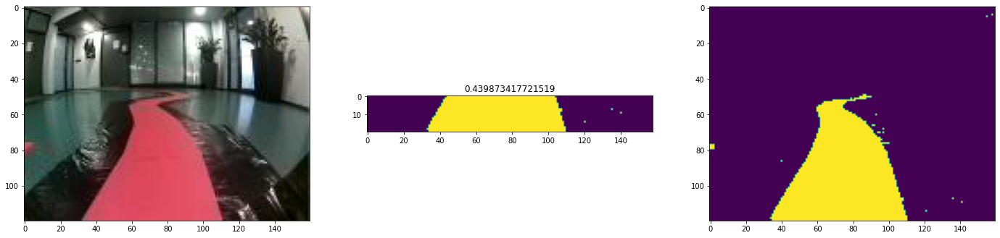

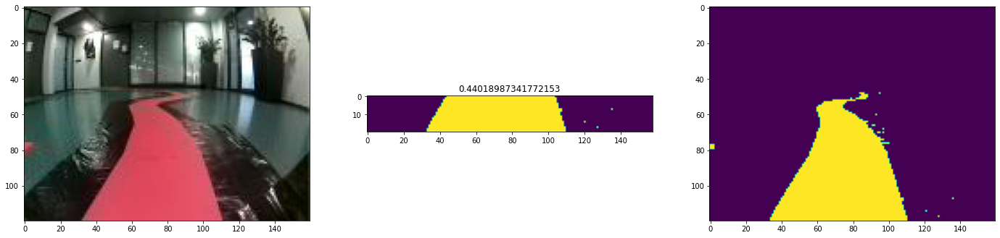

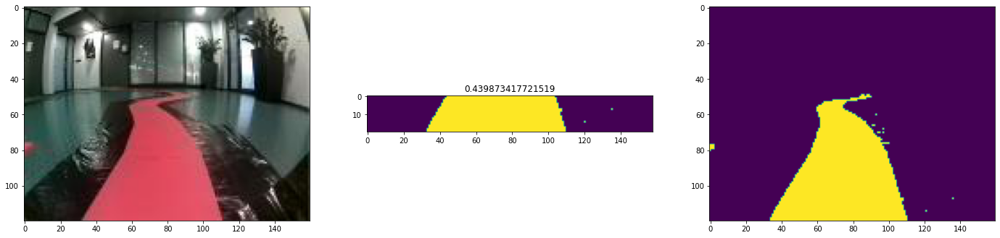

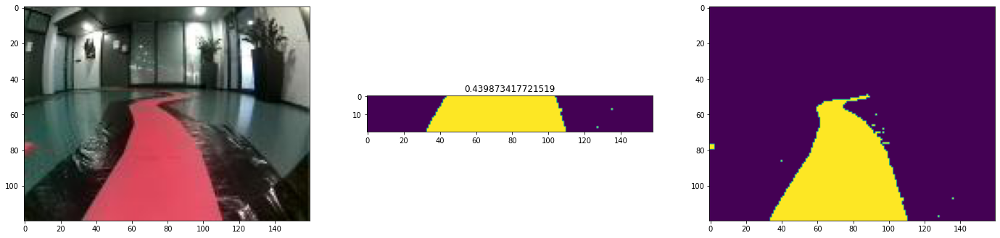

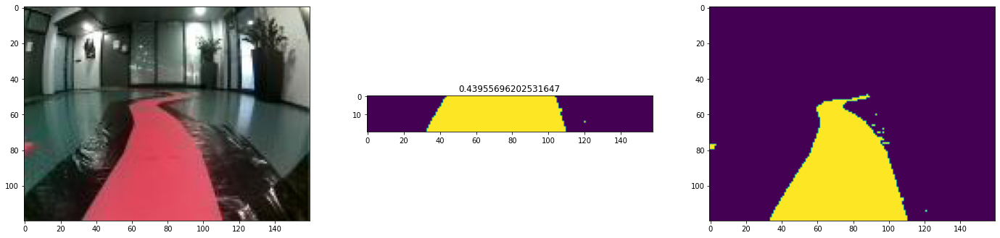

...

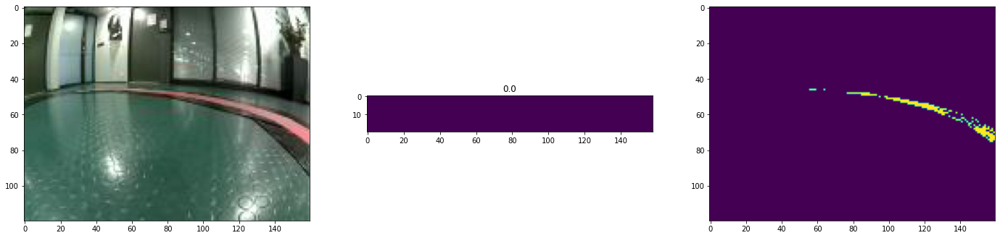

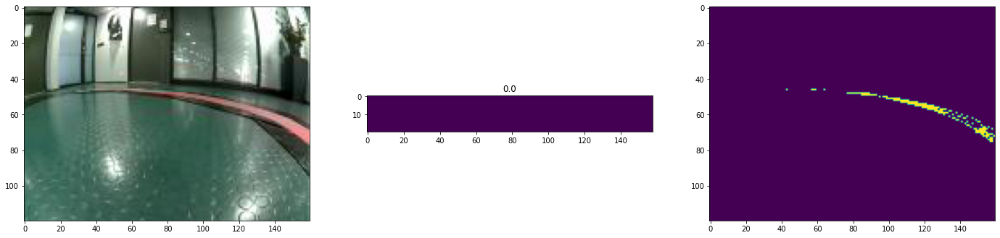

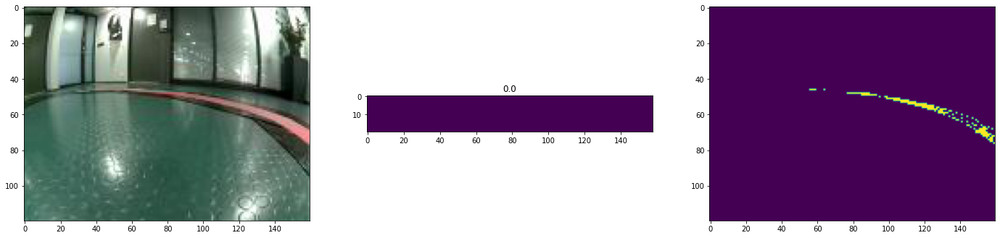

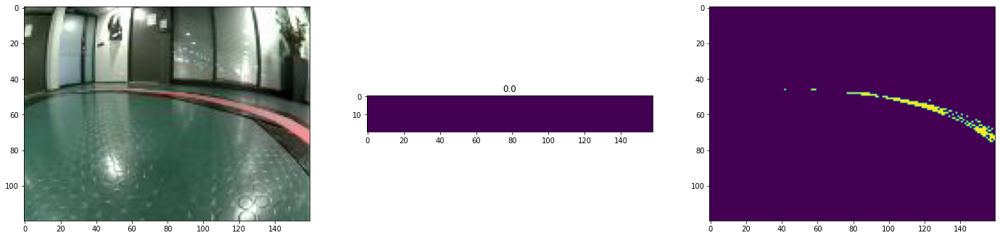

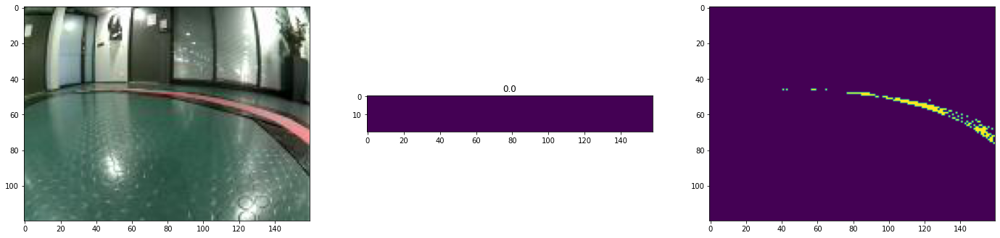

In [71]:
cims = 100

threshold = 150
crop_height = 20
crop_width = 1

for im in ims[::2]:
    gs = (im[:,:,0] > threshold) & (im[:,:,1] < 150) & (im[:,:,1] < 150)
    #gs = im[:,:,1]
    cropped = gs[-crop_height:, crop_width:-crop_width]
    plt.figure(1, (24, 8))
    plt.subplot(1, 3, 1)
    plt.imshow(im)
    plt.subplot(1, 3, 2)
    plt.imshow(cropped)
    #plt.imshow(im * (im > 200))
    plt.title(len(cropped[cropped]) / (crop_height * (160 - 2 * crop_width)))
    plt.subplot(1, 3, 3)
    plt.imshow(gs)  
    plt.show()

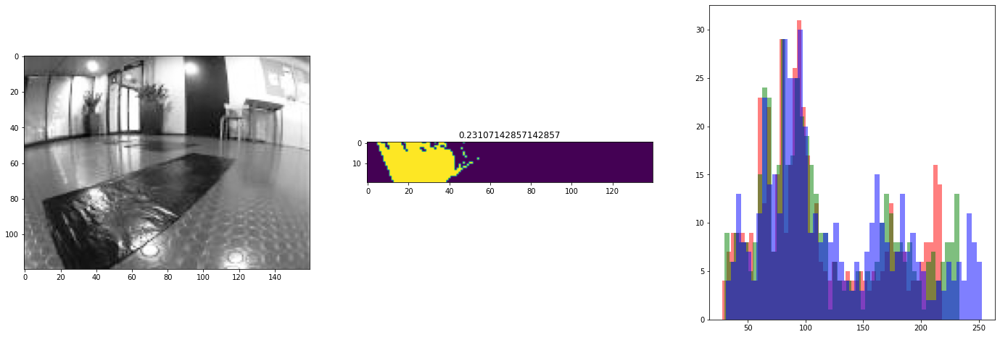

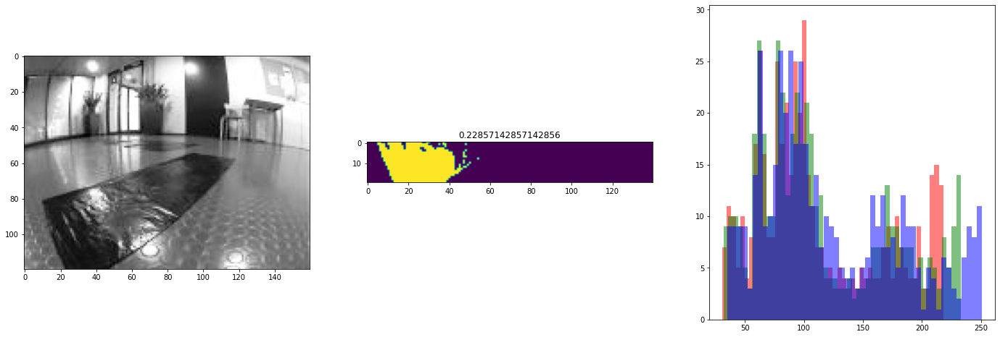

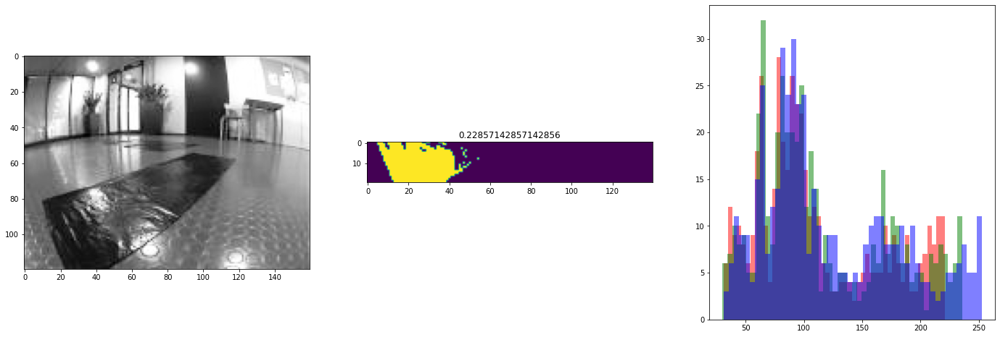

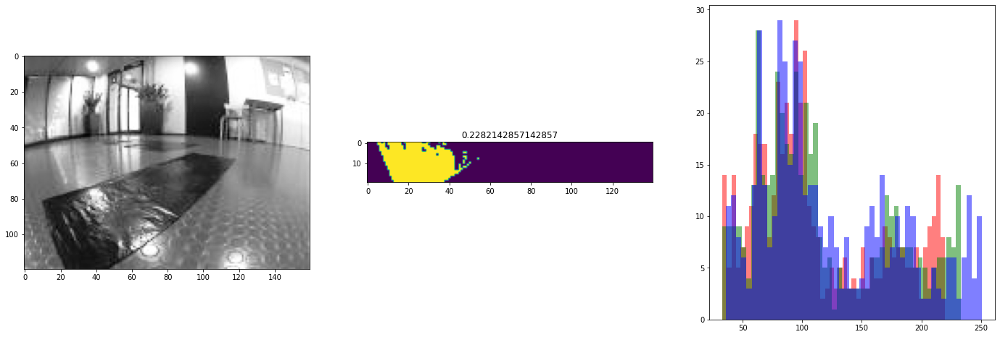

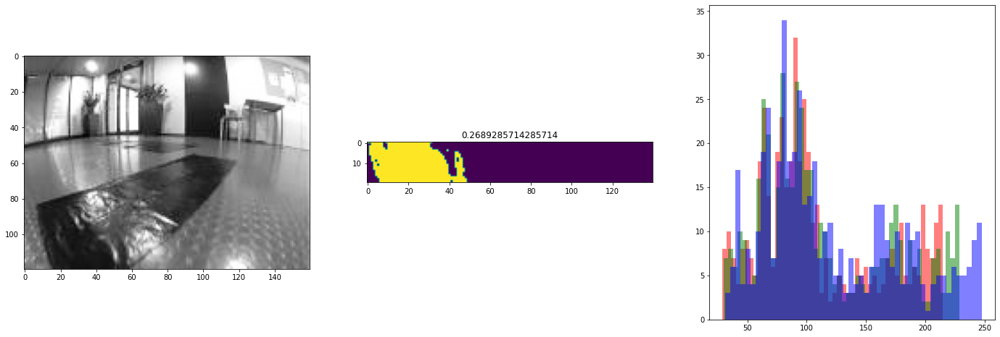

...

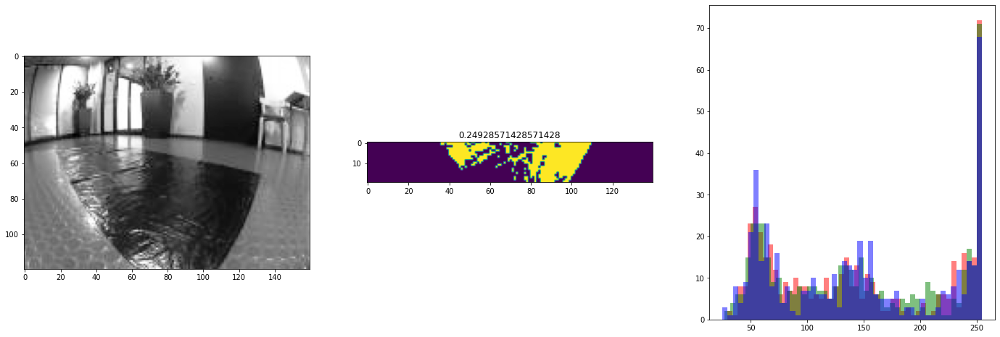

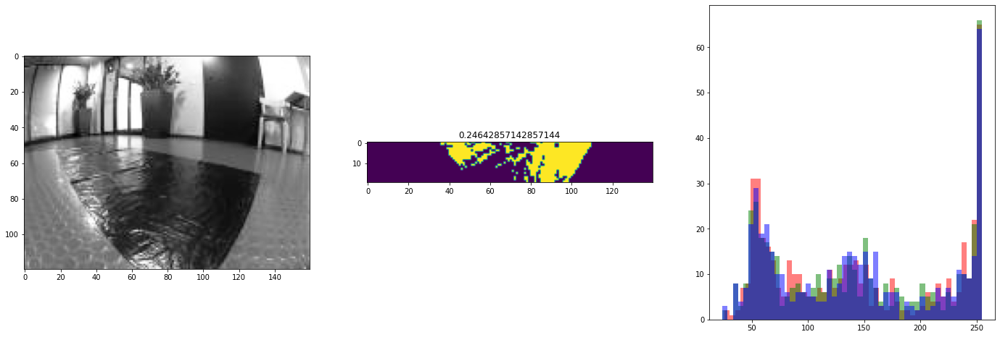

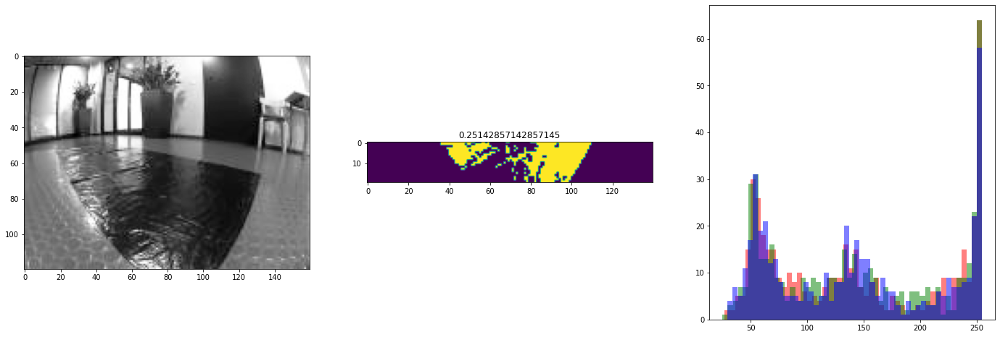

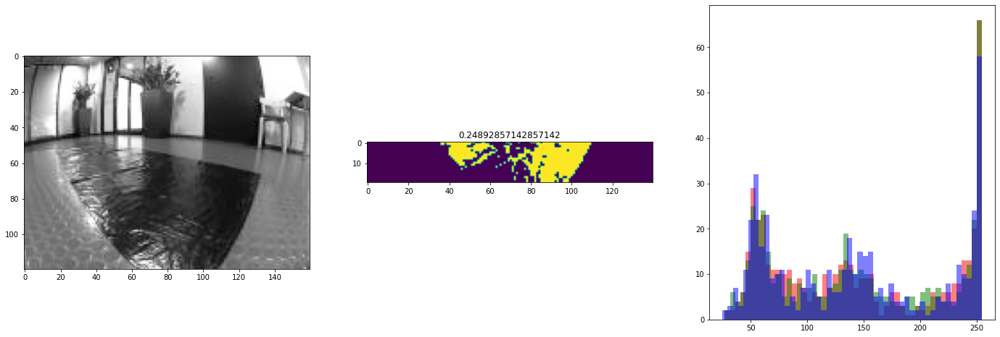

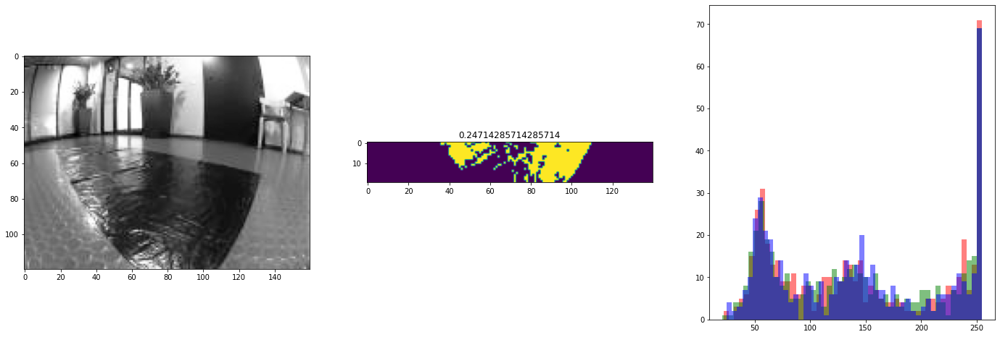

In [32]:
cims = 100

threshold = 50
crop_height = 20
crop_width = 10

for im in ims[::5]:
    gs = np.dot(im, [0.299, 0.587, 0.114])
    #gs = im[:,:,1]
    cropped = gs[-crop_height:, crop_width:-crop_width]
    plt.figure(1, (24, 8))
    plt.subplot(1, 3, 1)
    plt.imshow(gs, cmap="Greys_r")
    plt.subplot(1, 3, 2)
    plt.imshow(cropped < threshold)
    #plt.imshow(im * (im > 200))
    plt.title(len(cropped[cropped < threshold]) / (crop_height * (160 - 2 * crop_width)))
    plt.subplot(1, 3, 3)
    plt.hist(im[0].flatten(), color="r", bins=50, alpha=0.5)
    plt.hist(im[1].flatten(), color="g", bins=50, alpha=0.5)
    plt.hist(im[2].flatten(), color="b", bins=50, alpha=0.5)
    plt.show()

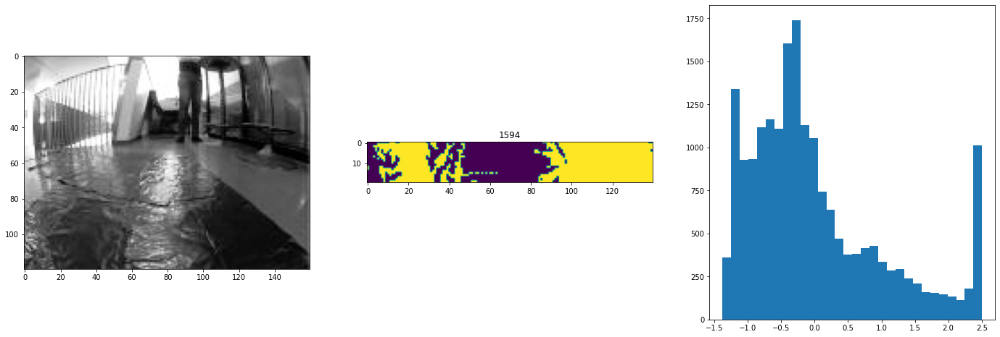

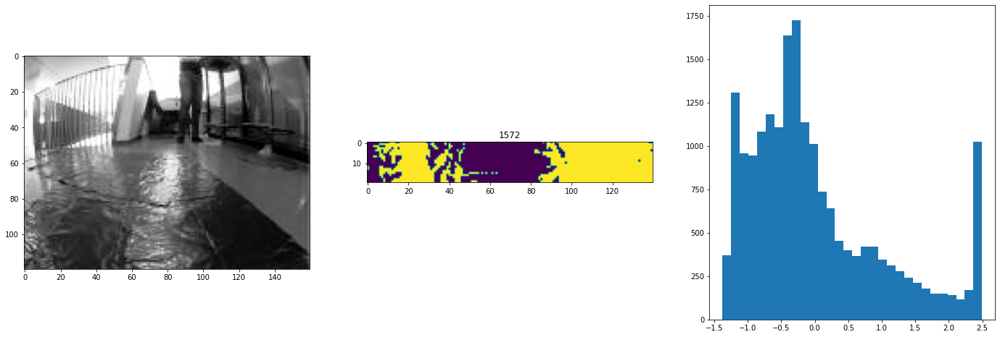

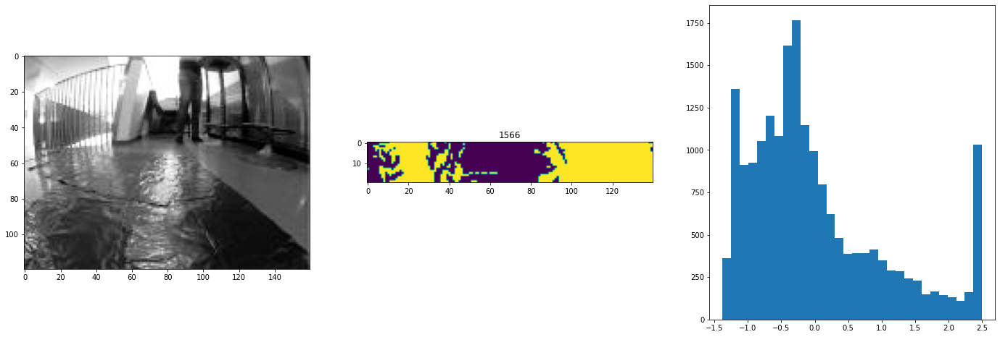

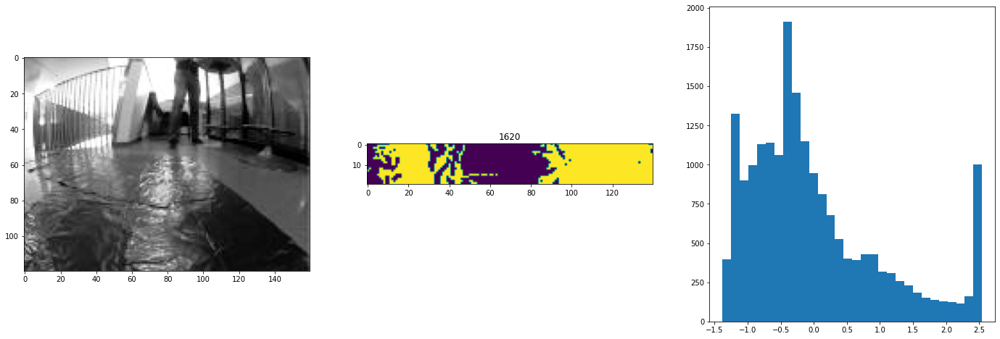

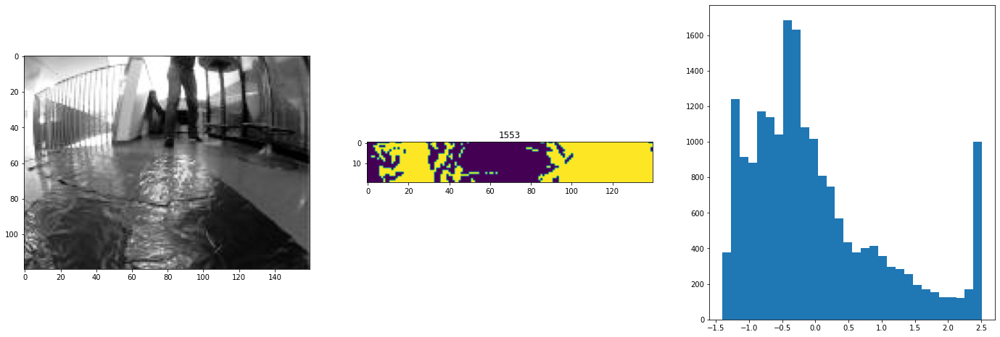

...

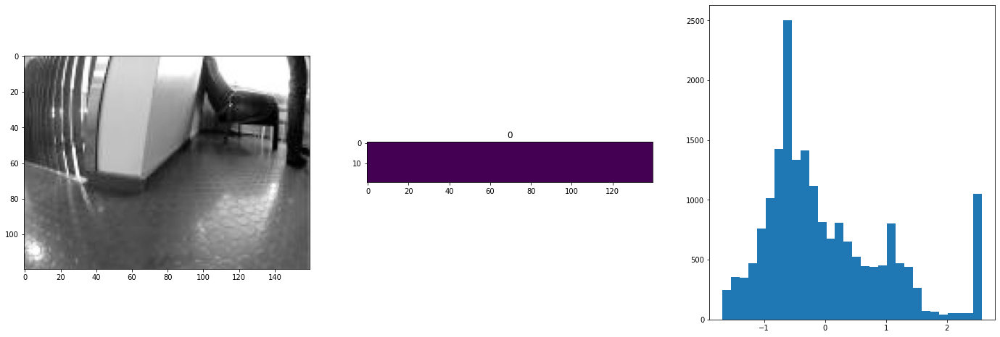

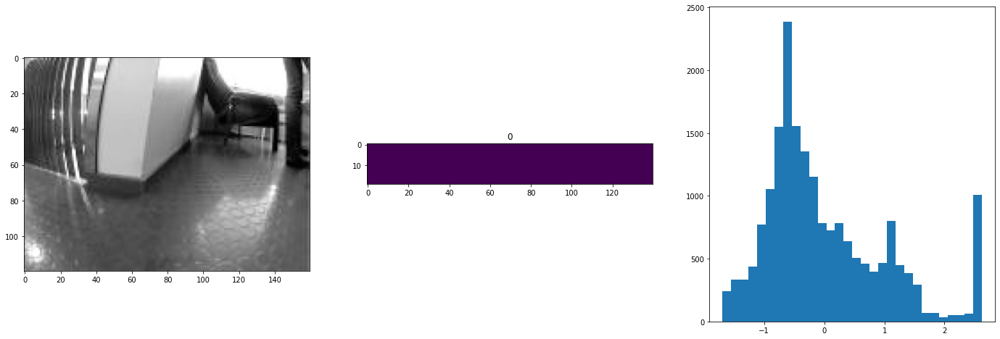

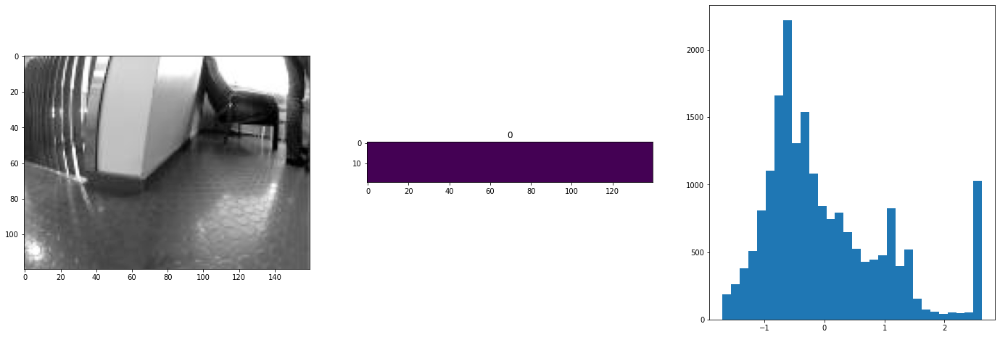

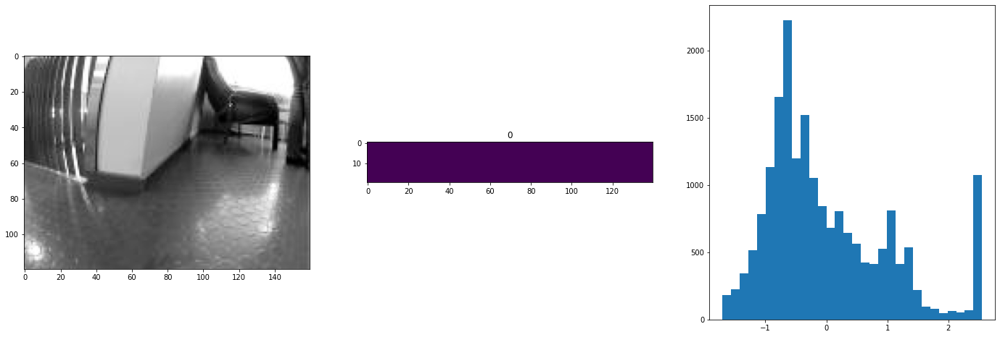

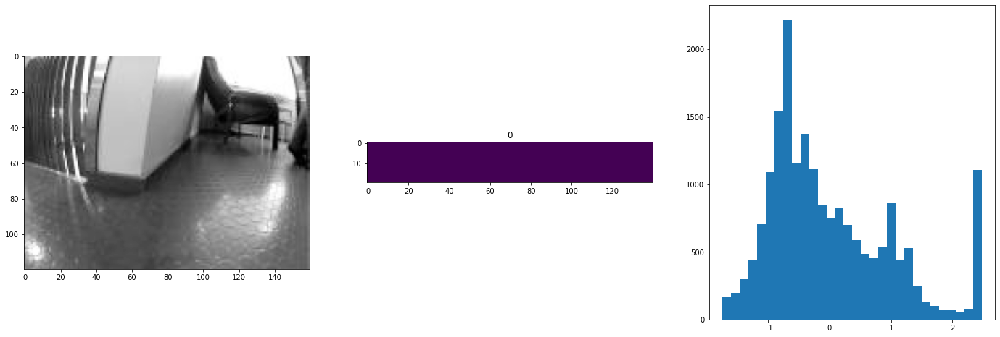

In [100]:
cims = 100

threshold = 40
crop_height = 20
crop_width = 10

for im in ims[::2]:
    gs = np.dot(im, [0.299, 0.587, 0.114])
    normed = (gs - gs.mean()) / gs.std()
    cropped = gs[-crop_height:, crop_width:-crop_width]
    plt.figure(1, (24, 8))
    plt.subplot(1, 3, 1)
    plt.imshow(normed, cmap="Greys_r")
    plt.subplot(1, 3, 2)
    plt.imshow(cropped < threshold)
    #plt.imshow(im * (im > 200))
    plt.title(len(cropped[cropped < threshold]))
    plt.subplot(1, 3, 3)
    plt.hist(normed.flatten(), bins=30)
    plt.show()

In [73]:
ims.append(controller.observe())

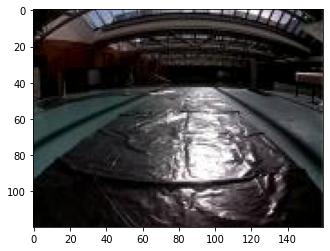

In [57]:
plt.imshow(controller.observe())

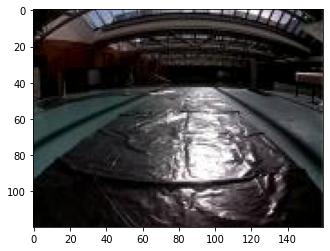

In [56]:
plt.imshow(ims[-1])

(array([54169.,     0.,     0.,     0.,     0.,     0.,     0.,   373.,
         2733.,   325.]),
 array([  0. ,  25.5,  51. ,  76.5, 102. , 127.5, 153. , 178.5, 204. ,
        229.5, 255. ]),
 <a list of 10 Patch objects>)

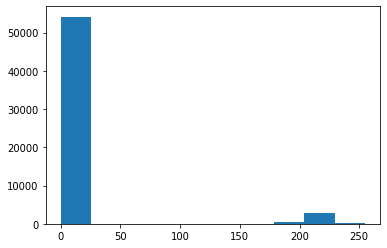

In [30]:
plt.hist((im * (im > 200)).flatten())

In [19]:
plt.hist?

Signature:
plt.hist(
    x,
    bins=None,
    range=None,
    density=False,
    weights=None,
    cumulative=False,
    bottom=None,
    histtype='bar',
    align='mid',
    orientation='vertical',
    rwidth=None,
    log=False,
    color=None,
    label=None,
    stacked=False,
    *,
    data=None,
    **kwargs,
)
Docstring:
Plot a histogram.

Compute and draw the histogram of *x*.  The return value is a tuple
(*n*, *bins*, *patches*) or ([*n0*, *n1*, ...], *bins*, [*patches0*,
*patches1*,...]) if the input contains multiple data.  See the
documentation of the *weights* parameter to draw a histogram of
already-binned data.

Multiple data can be provided via *x* as a list of datasets
of potentially different length ([*x0*, *x1*, ...]), or as
a 2-D ndarray in which each column is a dataset.  Note that
the ndarray form is transposed relative to the list form.

Masked arrays are not supported.

The *bins*, *range*, *weights*, and *density* parameters behave as in
`numpy.histogram`.

P

In [20]:
gs = np.dot(im, [0.299, 0.587, 0.114])

In [30]:
cropped = gs[100:]

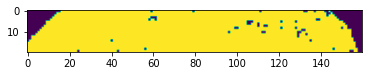

In [31]:
plt.imshow(cropped < 90)

In [17]:
len(im[(im > 120) * (im < 130)])

3081

In [13]:
plt.imshow(im > 120)

ValueError: Unsupported dtype

<Figure size 432x288 with 1 Axes>